## Player Types For Clustering ##

```
1) Box to Box Midfielder
2) Holding Midfielder
4) Advanced Playmaker
5) Deep Lying Playmaker
6) Winger
7) False 9
8) Striker 
9) Target Forward
10) Center-Back
11) Wing-Back
12) Full-Back
```

In [326]:
import sqlite3
import pandas as pd
import numpy as np
import seaborn as sns
import itertools
import matplotlib.pyplot as plt
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn import model_selection
from sklearn.model_selection import train_test_split
from sklearn.metrics import make_scorer
from time import time
from sklearn.decomposition import PCA, FastICA, NMF
from sklearn.cluster import KMeans
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

In [8]:
database = 'database.sqlite'
conn = sqlite3.connect(database)
query = "SELECT name FROM sqlite_master WHERE type='table';"
pd.read_sql(query, conn)

,name
0,sqlite_sequence
1,Player_Attributes
2,Player
3,Match
4,League
5,Country
6,Team
7,Team_Attributes


In [5]:
query = "SELECT * FROM Player;"
player_meta_data = pd.read_sql(query, conn)

In [25]:
query = "SELECT * FROM Team;"
team_data = pd.read_sql(query, conn)

In [9]:
query = "SELECT * FROM Player_Attributes;"
player_stats = pd.read_sql(query,conn)

In [31]:
query = "SELECT * FROM League;"
league_data = pd.read_sql(query, conn)

In [32]:
query = "SELECT * FROM Country;"
country_data = pd.read_sql(query, conn)

In [60]:
query = "SELECT * FROM Match;"
match_data = pd.read_sql(query, conn)

In [13]:
query = """SELECT * FROM Player_Attributes a
           INNER JOIN (SELECT player_name, player_api_id AS p_id FROM Player) b ON a.player_api_id = b.p_id;"""
player_stats_wname = pd.read_sql(query,conn)

In [67]:
player_mean_stats = player_stats_wname.groupby(['player_name']).mean()
players_data_2 = player_mean_stats.reset_index()

In [68]:
len(players_data_2)

10848

In [47]:
len(player_mean_stats['p_id'].unique())

10847

In [57]:
def get_current_team_and_country(x):
    global c
    all_rating = c.execute("""SELECT overall_rating FROM Player_Attributes WHERE player_api_id = '%d' """ % (x)).fetchall()
    all_rating = np.array(all_rating,dtype=np.float)[:,0]
    rating = np.nanmean(all_rating)
    if (rating>1): 
        all_football_nums = reversed(range(1,12))
        for num in all_football_nums:
            all_team_id = c.execute("""SELECT home_team_api_id, country_id FROM Match WHERE home_player_%d = '%d'""" % (num,x)).fetchall()
            if len(all_team_id) > 0:
                number_unique_teams = len(np.unique(np.array(all_team_id)[:,0]))
                last_team_id = all_team_id[-1][0]
                last_country_id = all_team_id[-1][1]
                last_country = c.execute("""SELECT name FROM Country WHERE id = '%d'""" % (last_country_id)).fetchall()[0][0]
                last_team = c.execute("""SELECT team_long_name FROM Team WHERE team_api_id = '%d'""" % (last_team_id)).fetchall()[0][0]
                return last_team, last_country, number_unique_teams
    return None, None, 0

In [58]:
conn = sqlite3.connect('database.sqlite')
c = conn.cursor()

In [69]:
# with sqlite3.connect('database.sqlite') as con:
#     sql = "SELECT * FROM Player"
#     max_players_to_analyze = 10848
#     players_data = pd.read_sql_query(sql, con)
#     players_data = players_data.iloc[0:max_players_to_analyze]
#     players_data["team"], players_data["country"], players_data["num_uniq_team"] = np.vectorize(get_current_team_and_country)(players_data["player_api_id"])

In [72]:
players_data.to_csv('playerteams.csv')

In [221]:
player_teams = pd.read_csv('playerteams.csv')
len(player_teams)

10848

In [220]:
players_final = pd.merge(players_data_2,player_teams, on = 'player_fifa_api_id')

/Users/evanhosmer/anaconda3/lib/python3.6/site-packages/pandas/core/reshape/merge.py:963: UserWarning:

You are merging on int and float columns where the float values are not equal to their int representation



10474

In [88]:
cols_drop = ['id_x','player_fifa_api_id','player_api_id_x','Unnamed: 0', 'id_y','player_api_id_y','player_name_y',
            'num_uniq_team']
df_players = players_final.drop(cols_drop,axis = 1)

In [96]:
league_country = pd.merge(league_data,country_data, on = 'id')
league_country.rename(columns={'name_y':'country'}, inplace=True)

In [319]:
final_players = pd.merge(df_players,league_country, on = 'country').drop(['p_id','id','country_id'], axis = 1)
test2 = final_players.drop(['player_name_x','gk_diving','gk_handling','gk_kicking','gk_positioning','gk_reflexes',
                           'birthday','height','weight','team','country','name_x'], axis = 1).dropna()
scaler = StandardScaler()
scaler.fit(test2)
std_data = scaler.transform(test2)
std_data

array([[-0.56590407, -0.79852947, -0.28773765, ...,  0.86723448,
         0.80268189,  0.99109375],
       [ 0.57644712,  0.76784835, -1.18009334, ...,  1.14757623,
         1.10591024,  0.89730168],
       [-0.78409808, -0.34504509, -1.11133762, ...,  0.63442101,
         0.74690481,  0.79336711],
       ...,
       [-1.21639495, -1.92788   , -0.99235019, ...,  0.527992  ,
         0.47663204,  0.48421666],
       [-2.62783742, -2.82176749, -0.20082509, ..., -0.61944581,
        -0.52612506, -0.70092759],
       [-2.3210021 , -1.23021172, -0.75954869, ..., -0.23904523,
        -0.32926477, -0.11747196]])

In [107]:
# final_players.drop(['birthday','height','weight'], axis = 1, inplace = True)

In [345]:
no_gks = final_players[final_players['gk_diving'] < 30].dropna()

In [346]:
len(no_gks)

8760

In [112]:
mean_league = no_gks.groupby(['name_x']).mean()

In [201]:
mean_leagues = mean_league.reset_index()

In [211]:
cols = mean_leagues.columns[2:31]
first = mean_leagues['overall_rating']
second = mean_leagues['name_x']
test = mean_leagues[cols]
for column in cols:
    mean = test[column].mean()
    std = test[column].std()
    test[column] = (test[column] - mean) / (std)
    
z_scores = pd.concat([first,test], axis = 1)
z_scores_name = pd.concat([second,z_scores], axis = 1)
z_scores_name.columns

/Users/evanhosmer/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



Index(['name_x', 'overall_rating', 'potential', 'crossing', 'finishing',
       'heading_accuracy', 'short_passing', 'volleys', 'dribbling', 'curve',
       'free_kick_accuracy', 'long_passing', 'ball_control', 'acceleration',
       'sprint_speed', 'agility', 'reactions', 'balance', 'shot_power',
       'jumping', 'stamina', 'strength', 'long_shots', 'aggression',
       'interceptions', 'positioning', 'vision', 'penalties', 'marking',
       'standing_tackle', 'sliding_tackle'],
      dtype='object')

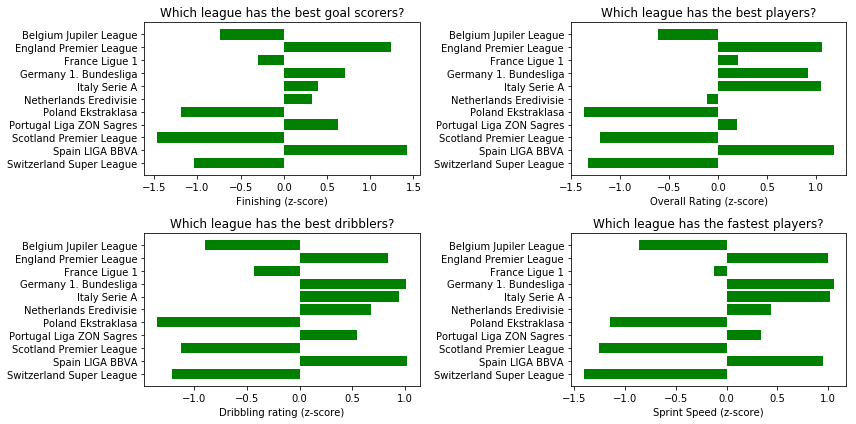

In [215]:
fig = plt.figure(figsize = (12,6))
ax = fig.add_subplot(221)

x = z_scores_name['finishing'].values
y = z_scores_name['name_x'].values

ax.barh(y, x, align='center',
        color='green', ecolor='black')
ax.set_yticks(range(len(y)))
ax.set_yticklabels(y)
ax.invert_yaxis()
ax.set_xlabel('Finishing (z-score)')
ax.set_title('Which league has the best goal scorers?')

ax = fig.add_subplot(222)

x2 = z_scores_name['overall_rating'].values
y2 = z_scores_name['name_x'].values

ax.barh(y2, x2, align='center',
        color='green', ecolor='black')
ax.set_yticks(range(len(y2)))
ax.set_yticklabels(y2)
ax.invert_yaxis()
ax.set_xlabel('Overall Rating (z-score)')
ax.set_title('Which league has the best players?')

ax = fig.add_subplot(223)

x3 = z_scores_name['dribbling'].values
y3 = z_scores_name['name_x'].values

ax.barh(y3, x3, align='center',
        color='green', ecolor='black')
ax.set_yticks(range(len(y3)))
ax.set_yticklabels(y3)
ax.invert_yaxis()
ax.set_xlabel('Dribbling rating (z-score)')
ax.set_title('Which league has the best dribblers?')

ax = fig.add_subplot(224)

x4 = z_scores_name['sprint_speed'].values
y4 = z_scores_name['name_x'].values

ax.barh(y4, x4, align='center',
        color='green', ecolor='black')
ax.set_yticks(range(len(y4)))
ax.set_yticklabels(y4)
ax.invert_yaxis()
ax.set_xlabel('Sprint Speed (z-score)')
ax.set_title('Which league has the fastest players?')

plt.tight_layout()

In [203]:
mean = mean_leagues['overall_rating'].mean()
std = mean_leagues['overall_rating'].std()

mean_leagues['overall_rating'] = (mean_leagues['overall_rating'] - mean) / (std)

In [172]:
cols = final_players.columns
feats = np.array(cols[1:31])
stats = final_players.loc[1548,feats].values
stats2 = final_players.loc[4721,feats].values

In [173]:
angles=np.linspace(0, 2*np.pi, len(feats), endpoint=False)
# close the plot
stats=np.concatenate((stats,[stats[0]]))
angles=np.concatenate((angles,[angles[0]]))
stats2 = np.concatenate((stats2,[stats2[0]]))

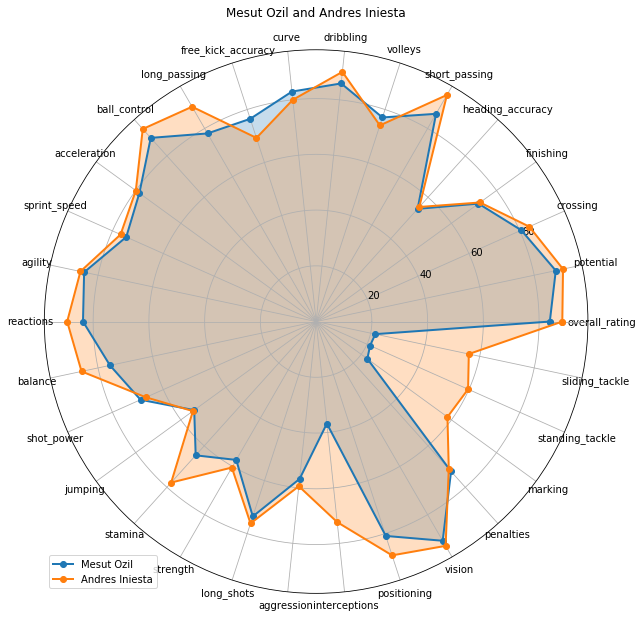

In [182]:
fig=plt.figure(figsize = (18,10))
ax = fig.add_subplot(111, polar=True)
ax.plot(angles, stats, 'o-', linewidth=2, label = 'Mesut Ozil')
ax.fill(angles, stats, alpha=0.25)
ax.plot(angles,stats2,'o-', linewidth=2, label = 'Andres Iniesta')
ax.fill(angles,stats2, alpha= 0.25)
ax.set_thetagrids(angles * 180/np.pi, feats)
ax.set_title('Mesut Ozil and Andres Iniesta')
ax.legend()
ax.grid(True)

In [216]:
def corr_heat(df):
    '''
    INPUT: Dataframe
    OUTPUT: Correlation Heat Map
    '''
    corr = df.corr()
    mask = np.zeros_like(corr, dtype=np.bool)
    mask[np.triu_indices_from(mask)] = True
    f, ax = plt.subplots(figsize=(12, 12))
    cmap = sns.diverging_palette(220, 10, as_cmap=True)
    sns.heatmap(corr, mask=mask, cmap=cmap, vmax=1, center=0,
                square=True, linewidths=.5, cbar_kws={"shrink": .5},xticklabels=corr.index, yticklabels=corr.columns)
    plt.xticks(rotation=60, ha="right")
    plt.yticks(rotation=0)
    ax.set_title("Correlation Heat Map")
    plt.show()

### Table with and without z-score

In [261]:
players = no_gks.drop(['gk_diving','gk_handling','gk_kicking','gk_positioning','gk_reflexes'],axis = 1)
players_no_z = players.copy(deep = True)

In [266]:
len(players_no_z)

9142

In [262]:
cols_feats = players.columns[1:31]
for column in cols_feats:
    mean = players[column].mean()
    std = players[column].std()
    players[column] = (players[column] - mean) / (std)

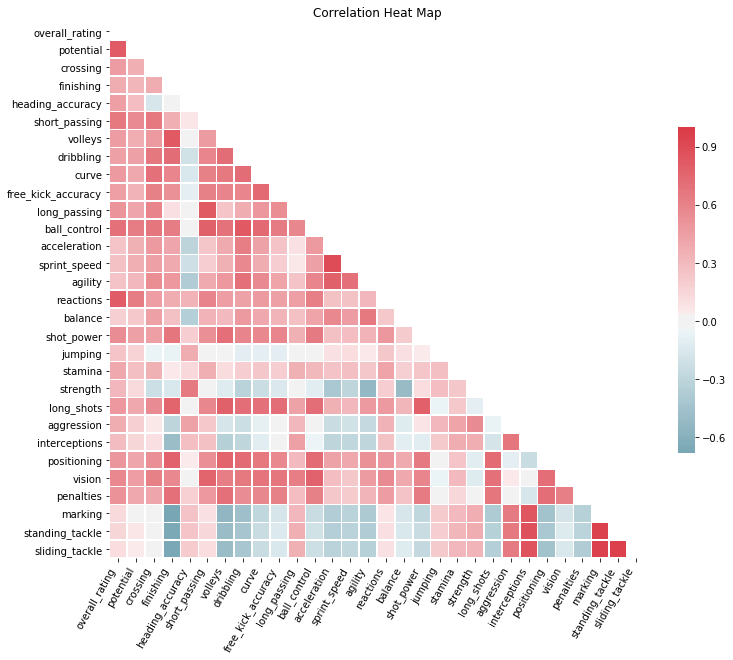

In [263]:
corr_heat(players_no_z)

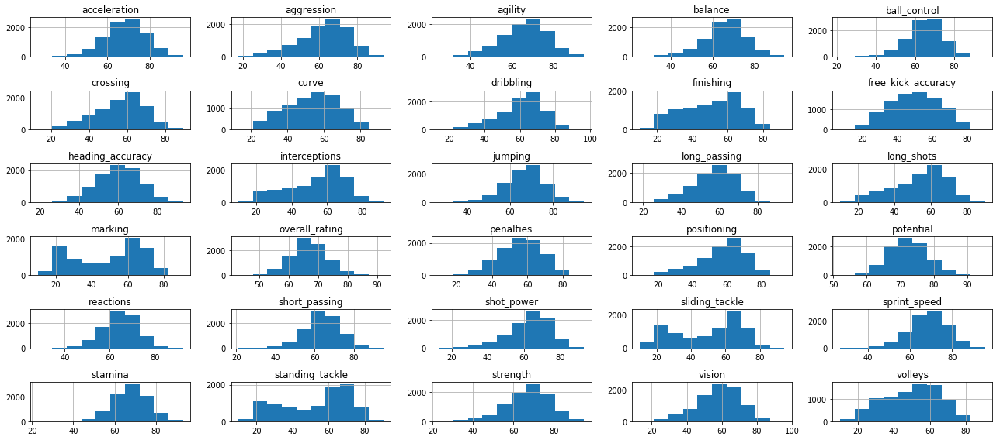

In [264]:
players_no_z.hist(figsize = (18,8))
plt.tight_layout()
plt.show()

In [265]:
overall = players_no_z.sort_values(by=['overall_rating'], ascending = False)
speed = players_no_z.sort_values(by=['sprint_speed'], ascending = False)
dribbling = players_no_z.sort_values(by=['dribbling'], ascending = False)
ball_control = players_no_z.sort_values(by=['ball_control'], ascending = False)
players_no_z['total_passing'] = (players_no_z['long_passing'] + players_no_z['short_passing'] + players_no_z['vision'] + players_no_z['crossing']) / 4
players_no_z['total_defending'] = (players_no_z['standing_tackle'] + players_no_z['sliding_tackle'] + players_no_z['marking'] + players_no_z['interceptions']) / 4
passing = players_no_z.sort_values(by=['total_passing'], ascending = False)
defending = players_no_z.sort_values(by=['total_defending'], ascending = False)


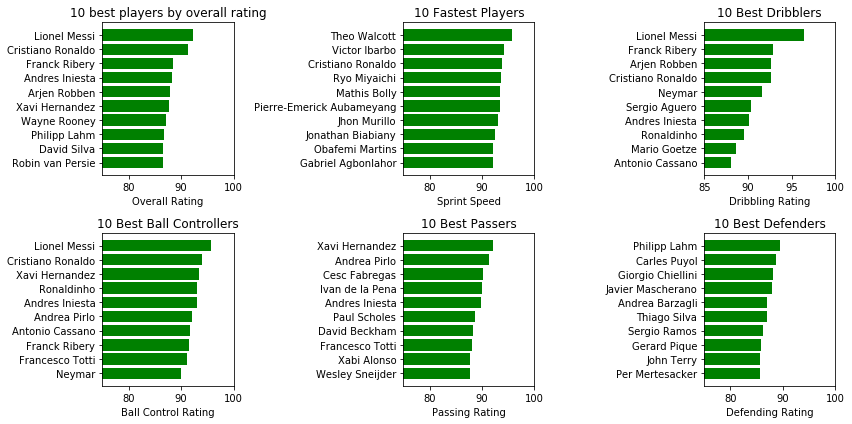

In [280]:
fig = plt.figure(figsize = (12,6))

ax = fig.add_subplot(231)
x = overall.iloc[0:10]['overall_rating'].values
y = overall.iloc[0:10]['player_name_x'].values

ax.barh(y, x, align='center',
        color='green', ecolor='black')
ax.set_yticks(range(len(y)))
ax.set_yticklabels(y)
ax.set_xlim(75,100)
ax.invert_yaxis()
ax.set_xlabel('Overall Rating')
ax.set_title('10 best players by overall rating')

ax2 = fig.add_subplot(232)
x2 = speed.iloc[0:10]['sprint_speed'].values
y2 = speed.iloc[0:10]['player_name_x'].values

ax2.barh(y2, x2, align='center',
        color='green', ecolor='black')
ax2.set_yticks(range(len(y2)))
ax2.set_yticklabels(y2)
ax2.set_xlim(75,100)
ax2.invert_yaxis()
ax2.set_xlabel('Sprint Speed')
ax2.set_title('10 Fastest Players')

ax3 = fig.add_subplot(233)
x3 = dribbling.iloc[0:10]['dribbling'].values
y3 = dribbling.iloc[0:10]['player_name_x'].values

ax3.barh(y3, x3, align='center',
        color='green', ecolor='black')
ax3.set_yticks(range(len(y3)))
ax3.set_yticklabels(y3)
ax3.set_xlim(85,100)
ax3.invert_yaxis()
ax3.set_xlabel('Dribbling Rating')
ax3.set_title('10 Best Dribblers')

ax4 = fig.add_subplot(234)
x4 = ball_control.iloc[0:10]['ball_control'].values
y4 = ball_control.iloc[0:10]['player_name_x'].values

ax4.barh(y4, x4, align='center',
        color='green', ecolor='black')
ax4.set_yticks(range(len(y4)))
ax4.set_yticklabels(y4)
ax4.set_xlim(75,100)
ax4.invert_yaxis()
ax4.set_xlabel('Ball Control Rating')
ax4.set_title('10 Best Ball Controllers')

ax5 = fig.add_subplot(235)
x5 = passing.iloc[0:10]['total_passing'].values
y5 = passing.iloc[0:10]['player_name_x'].values

ax5.barh(y5, x5, align='center',
        color='green', ecolor='black')
ax5.set_yticks(range(len(y5)))
ax5.set_yticklabels(y5)
ax5.set_xlim(75,100)
ax5.invert_yaxis()
ax5.set_xlabel('Passing Rating')
ax5.set_title('10 Best Passers')

ax6 = fig.add_subplot(236)
x6 = defending.iloc[0:10]['total_defending'].values
y6 = defending.iloc[0:10]['player_name_x'].values

ax6.barh(y6, x6, align='center',
        color='green', ecolor='black')
ax6.set_yticks(range(len(y6)))
ax6.set_yticklabels(y6)
ax6.set_xlim(75,100)
ax6.invert_yaxis()
ax6.set_xlabel('Defending Rating')
ax6.set_title('10 Best Defenders')

plt.tight_layout()

In [281]:
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [321]:
X = players_no_z.drop(['player_name_x','team','country','name_x','total_passing','total_defending'], axis = 1)
X = X.dropna()
X2 = players.dropna()
X2 = X2.drop(['player_name_x','team','country','name_x'], axis = 1)

In [322]:
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(X2.values, i) for i in range(X2.shape[1])]
vif["features"] = X.columns

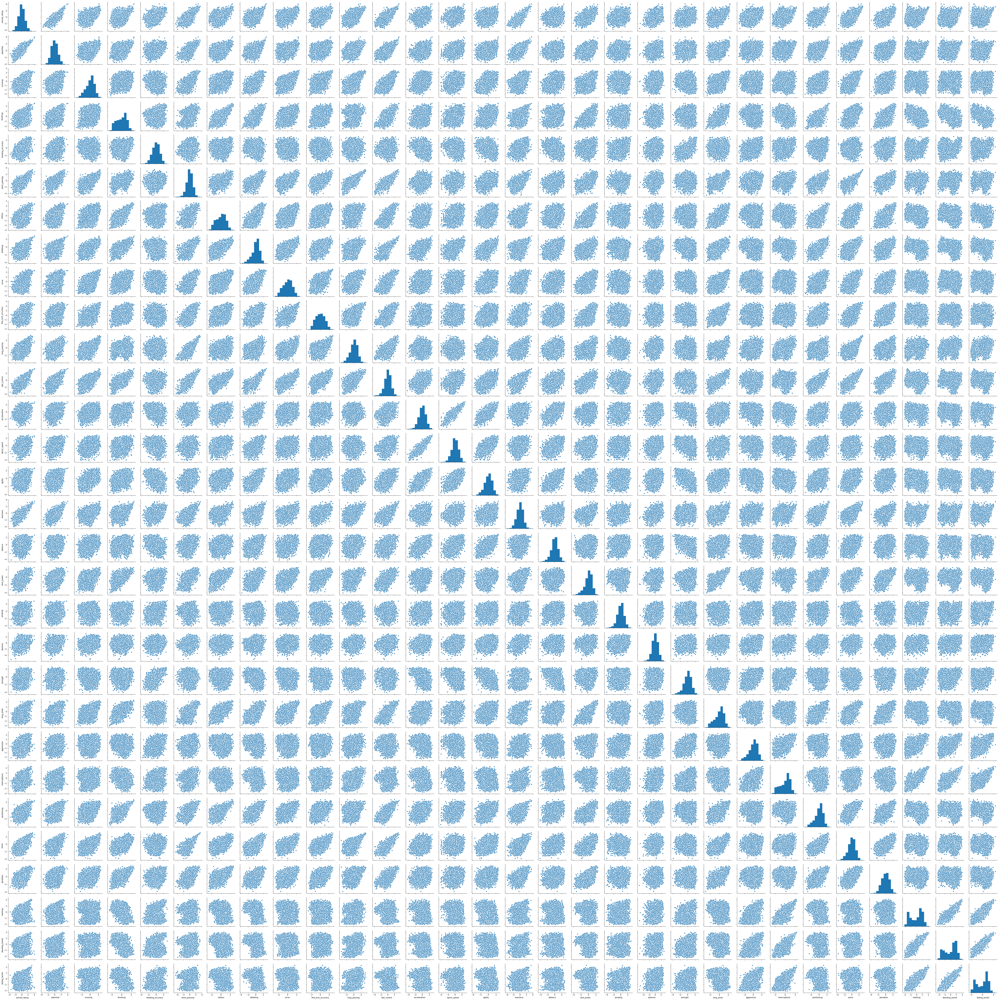

In [325]:
sns.pairplot(X2)

## Gonna need some PCA before clustering

In [333]:
def scree_plot(pca):
    vals = pca.explained_variance_ratio_
    plt.figure(figsize=(10, 6), dpi=250)
    cum_var = np.cumsum(vals)
    ax = plt.subplot(111)

    ax.plot(range(len(vals) + 1), np.insert(cum_var, 0, 0), color = 'r', marker = 'o')
    ax.bar(range(len(vals)), vals, alpha = 0.8)
    
    ax.axhline(0.9, color = 'g', linestyle = "--")
    ax.set_xlabel("Principal Component", fontsize=12)
    ax.set_ylabel("Variance Explained (%)", fontsize=12)

    plt.title("Scree Plot for Soccer Data", fontsize=16)

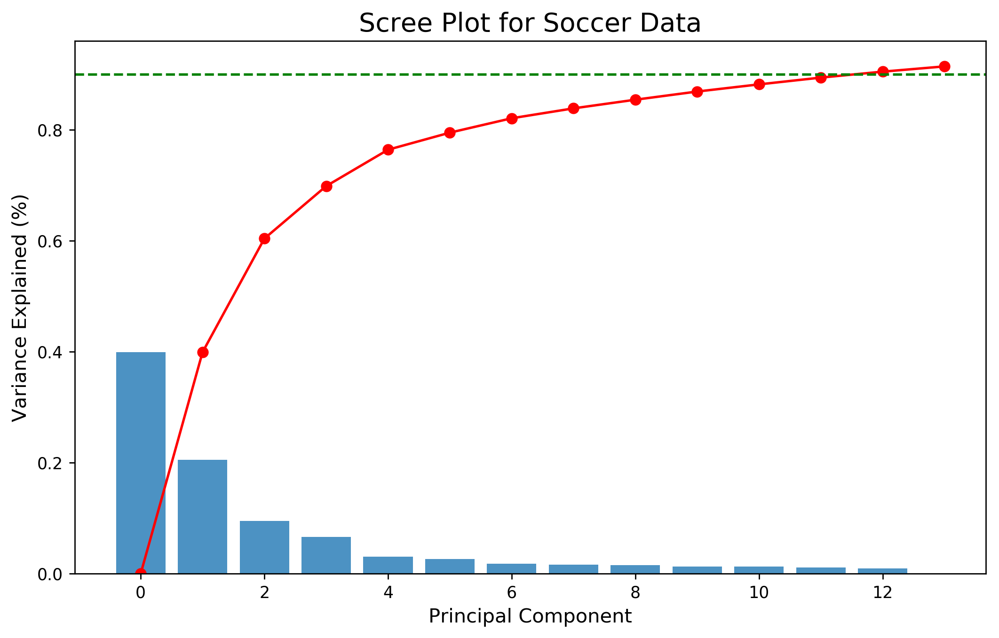

In [334]:
pca = PCA(n_components=13)
X_pca = pca.fit_transform(X2)
scree_plot(pca)

### K-Means